# 6.3 EV Choropleth Script

## This scripts will contain the following 

**1. Import data and libraries**

**2. Data Wrangling**

**3. Data Cleaning**

**4. Creating a Choropleth Map**

# 1. Importing Data and Libraries

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib
import os
import folium
import json
import geopandas as gpd

In [2]:
%matplotlib inline 

In [3]:
# Import JSON file

wa_counties = r'/Users/mitchellkubik/Desktop/Advanced Analytics & Dashboard Design/Assignment Data/Original EV Data/gz_2010_us_050_00_500k_new.json'

In [4]:
f = open(r'/Users/mitchellkubik/Desktop/Advanced Analytics & Dashboard Design/Assignment Data/Original EV Data/gz_2010_us_050_00_500k_new.json')

data=json.load(f)

for i in data ['features']:
    print(i)

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{'type': 'Feature', 'properties': {'GEO_ID': '0500000US72053', 'STATE': '72', 'COUNTY': '053', 'NAME': 'Fajardo', 'LSAD': 'Muno', 'CENSUSAREA': 29.864}, 'geometry': {'type': 'MultiPolygon', 'coordinates': [[[[-65.585693, 18.388322], [-65.585544, 18.388144], [-65.585136, 18.387656], [-65.584868, 18.387335], [-65.584612, 18.387029], [-65.584537, 18.386939], [-65.584047, 18.385323], [-65.583626, 18.383931], [-65.583577, 18.383772], [-65.583571, 18.383751], [-65.583627, 18.383725], [-65.587307, 18.382007], [-65.587335, 18.381994], [-65.587408, 18.382028], [-65.587856, 18.382235], [-65.591215, 18.383793], [-65.591505, 18.384483], [-65.591899, 18.385419], [-65.592667, 18.387243], [-65.592919, 18.388626], [-65.593393, 18.391237], [-65.592867, 18.391237], [-65.588128, 18.391237], [-65.585693, 18.388322]]], [[[-65.5708, 18.376094], [-65.571788, 18.375623], [-65.572225, 18.38145], [-65.572241, 18.381672], [-65.572248, 18.381757], [-65.571869, 18.381799], [-65.571359, 18.381857], [-65.570931, 18.

In [5]:
# Define path

path = r'/Users/mitchellkubik/Desktop/Advanced Analytics & Dashboard Design'

In [6]:
df = pd.read_csv(os.path.join(path, 'Assignment Data', 'Prepared EV Data', 'df_ev_cleaned.csv'))

In [7]:
# Check output

df.head()

,Unnamed: 0,vin,county,city,state,postal_code,year,make,model,ev_type,cafv_eligibility,electric_range,base_msrp,dol_v_id,v_location,electric_utility,2020_census_tract
0,0,2C4RC1N71H,Kitsap,Bremerton,WA,98311,2017,CHRYSLER,PACIFICA,Plug-in Hybrid Electric Vehicle (PHEV),Clean Alternative Fuel Vehicle Eligible,33,0,349437882,POINT (-122.6466274 47.6341188),PUGET SOUND ENERGY INC,5.303509e+10
1,1,2C4RC1N7XL,Stevens,Colville,WA,99114,2020,CHRYSLER,PACIFICA,Plug-in Hybrid Electric Vehicle (PHEV),Clean Alternative Fuel Vehicle Eligible,32,0,154690532,POINT (-117.90431 48.547075),AVISTA CORP,5.306595e+10
2,2,KNDC3DLCXN,Yakima,Yakima,WA,98908,2022,KIA,EV6,Battery Electric Vehicle (BEV),Eligibility unknown as battery range has not b...,0,0,219969144,POINT (-120.6027202 46.5965625),PACIFICORP,5.307700e+10
3,3,5YJ3E1EA0J,Kitsap,Bainbridge Island,WA,98110,2018,TESLA,MODEL 3,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,215,0,476786887,POINT (-122.5235781 47.6293323),PUGET SOUND ENERGY INC,5.303509e+10
4,4,1N4AZ1CP7J,Thurston,Tumwater,WA,98501,2018,NISSAN,LEAF,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,151,0,201185253,POINT (-122.89692 47.043535),PUGET SOUND ENERGY INC,5.306701e+10


In [8]:
df = df.drop('Unnamed: 0', axis = 1)

In [9]:
df.head()

,vin,county,city,state,postal_code,year,make,model,ev_type,cafv_eligibility,electric_range,base_msrp,dol_v_id,v_location,electric_utility,2020_census_tract
0,2C4RC1N71H,Kitsap,Bremerton,WA,98311,2017,CHRYSLER,PACIFICA,Plug-in Hybrid Electric Vehicle (PHEV),Clean Alternative Fuel Vehicle Eligible,33,0,349437882,POINT (-122.6466274 47.6341188),PUGET SOUND ENERGY INC,5.303509e+10
1,2C4RC1N7XL,Stevens,Colville,WA,99114,2020,CHRYSLER,PACIFICA,Plug-in Hybrid Electric Vehicle (PHEV),Clean Alternative Fuel Vehicle Eligible,32,0,154690532,POINT (-117.90431 48.547075),AVISTA CORP,5.306595e+10
2,KNDC3DLCXN,Yakima,Yakima,WA,98908,2022,KIA,EV6,Battery Electric Vehicle (BEV),Eligibility unknown as battery range has not b...,0,0,219969144,POINT (-120.6027202 46.5965625),PACIFICORP,5.307700e+10
3,5YJ3E1EA0J,Kitsap,Bainbridge Island,WA,98110,2018,TESLA,MODEL 3,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,215,0,476786887,POINT (-122.5235781 47.6293323),PUGET SOUND ENERGY INC,5.303509e+10
4,1N4AZ1CP7J,Thurston,Tumwater,WA,98501,2018,NISSAN,LEAF,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,151,0,201185253,POINT (-122.89692 47.043535),PUGET SOUND ENERGY INC,5.306701e+10


In [10]:
df.shape

(159458, 16)

In [11]:
df.rename(columns = {'2020_census_tract' : 'geo_id'}, inplace = True)

## 2. Data Wrangling

In [12]:
# Create subset with only the necessary columns

columns = ['county', 'city', 'state', 'year', 'make','model', 'ev_type', 'electric_range', 'dol_v_id']

In [13]:
# Create a subset

df_2 = df[columns]

In [14]:
df_2.head()

,county,city,state,year,make,model,ev_type,electric_range,dol_v_id
0,Kitsap,Bremerton,WA,2017,CHRYSLER,PACIFICA,Plug-in Hybrid Electric Vehicle (PHEV),33,349437882
1,Stevens,Colville,WA,2020,CHRYSLER,PACIFICA,Plug-in Hybrid Electric Vehicle (PHEV),32,154690532
2,Yakima,Yakima,WA,2022,KIA,EV6,Battery Electric Vehicle (BEV),0,219969144
3,Kitsap,Bainbridge Island,WA,2018,TESLA,MODEL 3,Battery Electric Vehicle (BEV),215,476786887
4,Thurston,Tumwater,WA,2018,NISSAN,LEAF,Battery Electric Vehicle (BEV),151,201185253


In [15]:
type(df_2)

pandas.core.frame.DataFrame

## 3. Data Cleaning

**Missing Values Check**

In [16]:
df_2.isnull().sum() # No missing values

county            0
city              0
state             0
year              0
make              0
model             0
ev_type           0
electric_range    0
dol_v_id          0
dtype: int64

**Duplicates Check**

<Axes: xlabel='year', ylabel='Count'>

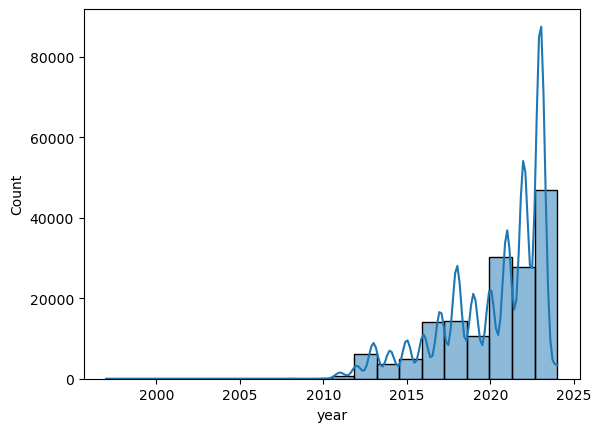

In [17]:
sns.histplot(df_2['year'], bins = 20, kde = True)

<Axes: xlabel='electric_range', ylabel='Count'>

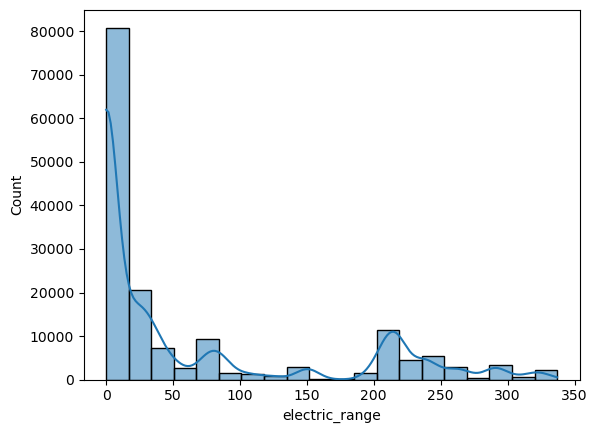

In [18]:
sns.histplot(df_2['electric_range'], bins=20, kde = True)

In [19]:
df_range = df_2[df_2['electric_range'] > 1]

<Axes: xlabel='electric_range', ylabel='Count'>

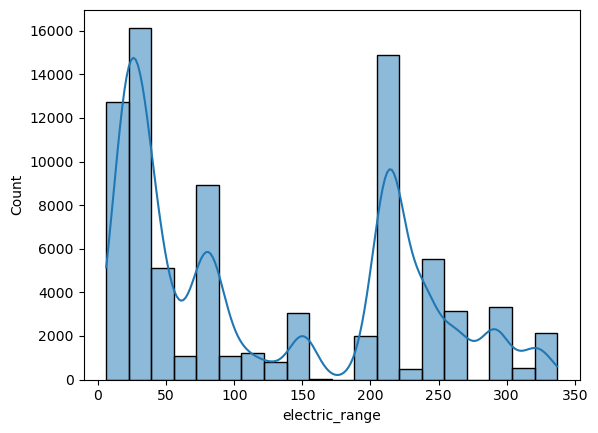

In [20]:
sns.histplot(df_range['electric_range'], bins = 20, kde = True)

In [21]:
df_wa_counties = df_2[df_2['state'] == 'WA']

In [22]:
df_wa_counties

,county,city,state,year,make,model,ev_type,electric_range,dol_v_id
0,Kitsap,Bremerton,WA,2017,CHRYSLER,PACIFICA,Plug-in Hybrid Electric Vehicle (PHEV),33,349437882
1,Stevens,Colville,WA,2020,CHRYSLER,PACIFICA,Plug-in Hybrid Electric Vehicle (PHEV),32,154690532
2,Yakima,Yakima,WA,2022,KIA,EV6,Battery Electric Vehicle (BEV),0,219969144
3,Kitsap,Bainbridge Island,WA,2018,TESLA,MODEL 3,Battery Electric Vehicle (BEV),215,476786887
4,Thurston,Tumwater,WA,2018,NISSAN,LEAF,Battery Electric Vehicle (BEV),151,201185253
...,...,...,...,...,...,...,...,...,...
159453,Skamania,Underwood,WA,2023,HYUNDAI,TUCSON,Plug-in Hybrid Electric Vehicle (PHEV),33,235949514
159454,Skagit,Bow,WA,2021,CHEVROLET,BOLT EV,Battery Electric Vehicle (BEV),0,148544168
159455,King,Sammamish,WA,2023,VOLVO,XC90,Plug-in Hybrid Electric Vehicle (PHEV),32,240200754
159456,Whatcom,Bellingham,WA,2019,TESLA,MODEL 3,Battery Electric Vehicle (BEV),220,156680590


In [27]:
df_wa_counties.to_csv(os.path.join(path, 'Assignment Data', 'Prepared EV Data', 'WA Counties Only.csv'))

## 4. Plot Choropleth

In [23]:
# Create a df with just the counties and the sum of vehicles

data_to_plot = (df_wa_counties.groupby('county')
               .size()
               .to_frame(name='vehicle_count')
               .reset_index()
               .sort_values(by='vehicle_count', ascending = False))

In [24]:
data_to_plot.head()

,county,vehicle_count
16,King,83413
30,Snohomish,18544
26,Pierce,12315
5,Clark,9364
33,Thurston,5711


In [25]:
# Set up a folium map at a high_level zoom

map = folium.Map(location = [47, -120], zoom_start = 7)

# Bind df with json file

folium.Choropleth(
geo_data = wa_counties,
data = data_to_plot,
columns = ['county', 'vehicle_count'],
key_on = 'feature.properties.NAME',
fill_color = 'YlOrBr', fill_opacity=0.6, line_opacity=0.1,
legend_name = 'ev_count_by_county'). add_to(map)

map

In [26]:
map.save('plot_data.html')

The map shows that the majority of EV's are purchased in the counties King, Snohomish, and Pierce. 